# Initial Analysis of Data From Single Agent Acting on Raw Actuators

In [1]:
%matplotlib notebook
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os

In [2]:
import glob
interaction_data_files = glob.glob('raw_act_single_agent/interaction_data/*.csv')
interaction_data_files.sort()

In [3]:
interaction_data_files

['raw_act_single_agent/interaction_data/20180925-111813.csv',
 'raw_act_single_agent/interaction_data/20180928-123909.csv',
 'raw_act_single_agent/interaction_data/20181002-103409.csv',
 'raw_act_single_agent/interaction_data/20181005-094729.csv']

In [4]:
interaction_data = {}
for file in interaction_data_files:
    interaction_data[file] = pd.read_csv(file)
    def convert_str_to_matrix(data):
        # remove '\r\n', '[', ']', then split with ' '
        temp_list = data.replace('\r\n', '').replace('[','').replace(']','').split(' ')
        return np.array([float(item) for item in temp_list if item != ''])
    interaction_data[file]['Observation'] = interaction_data[file]['Observation'].apply(convert_str_to_matrix)
    interaction_data[file]['Action'] = interaction_data[file]['Action'].apply(convert_str_to_matrix)
    print(interaction_data[file].shape)

(3637, 4)
(3638, 4)
(1868, 4)
(3322, 4)


## Concatenate Action Data

In [5]:
interaction_data_all = {}
interaction_data_all['data'] = pd.DataFrame()
interaction_data_all['separate_line'] = []
interaction_data_all['date'] = []
for key in interaction_data.keys():
    interaction_data_all['data'] = pd.concat([interaction_data_all['data'], interaction_data[key]])
    interaction_data_all['separate_line'].append(len(interaction_data[key]))
    interaction_data_all['date'].append(key.split('/')[2].split('-')[0])

## Plot Action Data
Note: I used $\epsilon$-greedy exploration which starts from 0.5 and discounts to 0.05 with discounting rate 0.9, and I forget to save $\epsilon$ every day, so each day the $\epsilon$ will discount from 0.5 to 0.005. So, probably the values between -1 and 1 are random values, but $\epsilon$ will discount to 0.05 very quickly using less than 200 steps which is inconsistent with what we can see from figures. It seems the action got stuck on on or off for a while, then switch between these two extrem value. 

In [6]:
import numpy as np
epsilon = 0.5
for i in range(200):
    if np.random.rand(1) <= epsilon:
        if epsilon > 0.05:
            epsilon *= 0.9
        else:
            print('epsilon reduced to <0.05 after {} steps'.format(i))
            break
    else:
        pass

In [7]:
# Convert action into np.array
action = np.array(interaction_data_all['data']['Action'].tolist())
# read action_space_name
action_space_name = pd.read_csv('action_space_name_raw.csv')

node_num = 24
SMA_num_each_node = 6
LED_num_each_node = 1
Moth_num_each_node = 1
actuator_num_each_node = SMA_num_each_node+LED_num_each_node+Moth_num_each_node # 6 SMA, 1 LED and 1 Moth

for node_i in range(node_num):
    # plot 6 SMA
    plt.figure()
    for sma_j in range(SMA_num_each_node):
        plt.subplot(SMA_num_each_node/2, 2, sma_j+1)
        plt.scatter(np.arange(action.shape[0]), action[:,node_i*actuator_num_each_node+sma_j], s=1)
        for separate_line in interaction_data_all['separate_line']:
            plt.axvline(x = separate_line, color = 'r', linestyle=':')
        plt.xlabel('steps')
        plt.ylabel('action value')
        plt.title('{}'.format(action_space_name['actuator_name'][node_i*actuator_num_each_node+sma_j]))
    plt.tight_layout()
    # plot LED
    plt.figure()
    plt.scatter(np.arange(action.shape[0]), action[:,node_i*actuator_num_each_node+6], s=1)
    for separate_line in interaction_data_all['separate_line']:
        plt.axvline(x = separate_line, color = 'r', linestyle=':')
    plt.xlabel('steps')
    plt.ylabel('action value')
    plt.title('{}'.format(action_space_name['actuator_name'][node_i*actuator_num_each_node+6]))
    plt.tight_layout()
    # plot Moth
    plt.figure()
    plt.scatter(np.arange(action.shape[0]), action[:,node_i*actuator_num_each_node+7], s=1)
    for separate_line in interaction_data_all['separate_line']:
        plt.axvline(x = separate_line, color = 'r', linestyle=':')
    plt.xlabel('steps')
    plt.ylabel('action value')
    plt.title('{}'.format(action_space_name['actuator_name'][node_i*actuator_num_each_node+7]))
    plt.tight_layout()

In [8]:
# Convert action into np.array
action = np.array(interaction_data_all['data']['Action'].tolist())
# read action_space_name
action_space_name = pd.read_csv('action_space_name_raw.csv')
action_space_name.columns


Index(['actuator_name', 'index'], dtype='object')

In [25]:
action_df = pd.DataFrame(action, columns = action_space_name['actuator_name'])
action_df.to_csv('./SARA_actions.csv', index=False)
action_df.shape

(12465, 192)

In [10]:
action_df.columns

Index(['sma1_node#1', 'sma2_node#1', 'sma3_node#1', 'sma4_node#1',
       'sma5_node#1', 'sma6_node#1', 'light_node#1', 'moth_node#1',
       'sma1_node#2', 'sma2_node#2',
       ...
       'light_node#23', 'moth_node#23', 'sma1_node#24', 'sma2_node#24',
       'sma3_node#24', 'sma4_node#24', 'sma5_node#24', 'sma6_node#24',
       'light_node#24', 'moth_node#24'],
      dtype='object', name='actuator_name', length=192)

In [11]:
# for i in range(action_df.shape[1]):
#     plt.figure()
#     plt.hist(action_df[action_df.columns[i]])
#     plt.title('{}'.format(action_space_name['actuator_name'][i]))

# Action Cluster: t-SNE

In [12]:
action_df.values.shape

(12465, 192)

In [26]:
interaction_data_all['separate_line']
day_1 = interaction_data_all['separate_line'][0]
day_2 = interaction_data_all['separate_line'][1]
day_3 = interaction_data_all['separate_line'][2]
day_4 = interaction_data_all['separate_line'][3]


[3637, 3638, 1868, 3322]

In [14]:
from sklearn.manifold import TSNE
tsne_2d = TSNE(n_components=2, random_state=0, verbose=1)

In [15]:
X = action_df.values
X_2d = tsne_2d.fit_transform(X)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 12465 samples in 0.064s...
[t-SNE] Computed neighbors for 12465 samples in 21.349s...
[t-SNE] Computed conditional probabilities for sample 1000 / 12465
[t-SNE] Computed conditional probabilities for sample 2000 / 12465
[t-SNE] Computed conditional probabilities for sample 3000 / 12465
[t-SNE] Computed conditional probabilities for sample 4000 / 12465
[t-SNE] Computed conditional probabilities for sample 5000 / 12465
[t-SNE] Computed conditional probabilities for sample 6000 / 12465
[t-SNE] Computed conditional probabilities for sample 7000 / 12465
[t-SNE] Computed conditional probabilities for sample 8000 / 12465
[t-SNE] Computed conditional probabilities for sample 9000 / 12465
[t-SNE] Computed conditional probabilities for sample 10000 / 12465
[t-SNE] Computed conditional probabilities for sample 11000 / 12465
[t-SNE] Computed conditional probabilities for sample 12000 / 12465
[t-SNE] Computed conditional probabilities for sa

## ALL Days

<IPython.core.display.Javascript object>


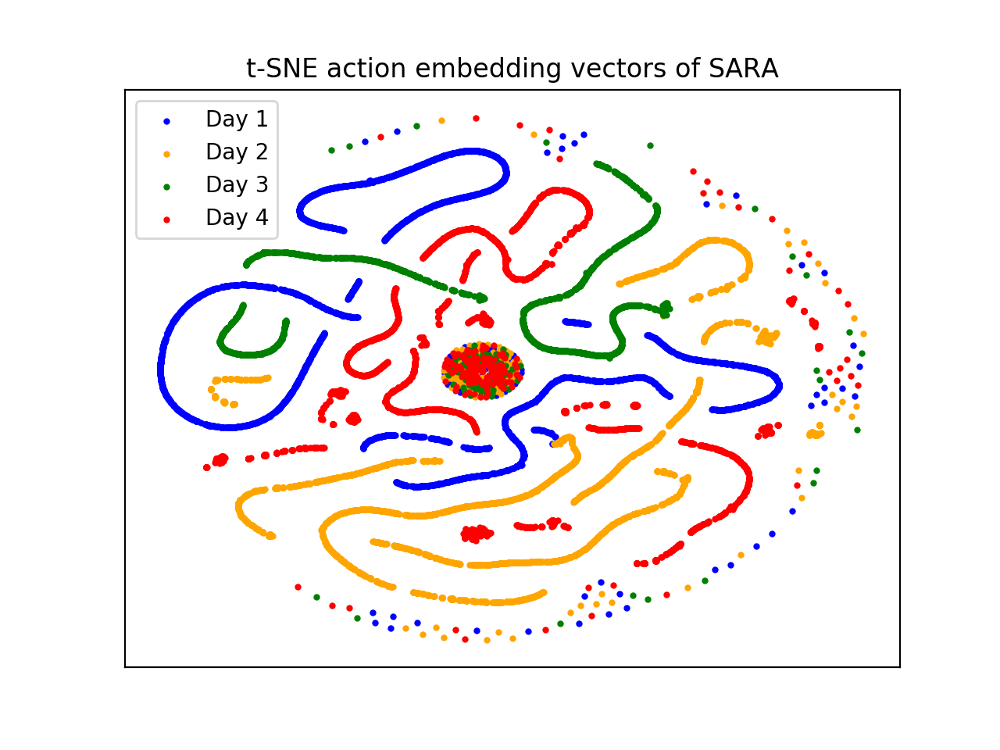

In [33]:
plt.figure()
# plt.scatter(X_2d[:,0], X_2d[:,1])
plt.scatter(X_2d[:day_1,0], X_2d[:day_1,1],c='blue',s=4)
plt.scatter(X_2d[day_1:day_1+day_2,0], X_2d[day_1:day_1+day_2,1],c='orange',s=4)
plt.scatter(X_2d[day_1+day_2:day_1+day_2+day_3,0], X_2d[day_1+day_2:day_1+day_2+day_3,1],c='green',s=4)
plt.scatter(X_2d[day_1+day_2+day_3:,0], X_2d[day_1+day_2+day_3:,1],c='red',s=4)
plt.xticks([])
plt.yticks([])
plt.legend(['Day 1', 'Day 2', 'Day 3', 'Day 4'])
plt.title('t-SNE action embedding vectors of SARA')
plt.savefig('./figures/SARA_action_pie_plots/t_SNE_action_embedding_vectors_of_SARA.jpg',
         dpi=300, bbox_inches='tight', pad_inches=0)

## On Each Day

<IPython.core.display.Javascript object>


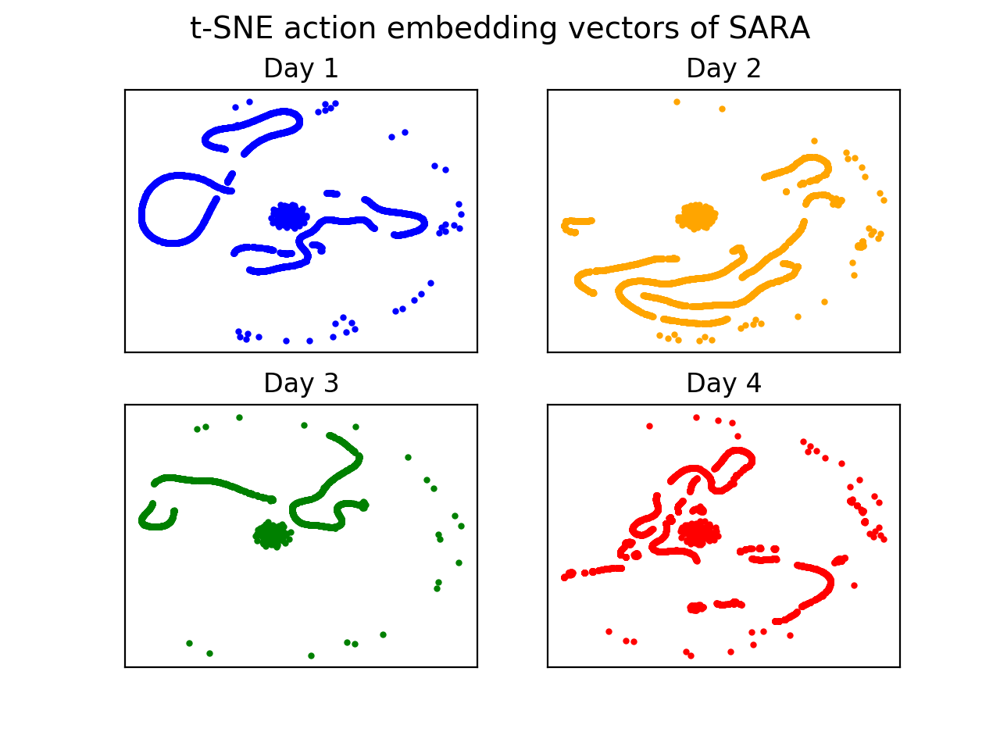

In [34]:
fig = plt.figure()
fig.suptitle('t-SNE action embedding vectors of SARA',fontsize=14) 

plt.subplot(2,2,1)
plt.scatter(X_2d[:day_1,0], X_2d[:day_1,1],c='blue',s=4)
plt.xticks([])
plt.yticks([])
plt.title('Day 1')

plt.subplot(2,2,2)
plt.scatter(X_2d[day_1:day_1+day_2,0], X_2d[day_1:day_1+day_2,1],c='orange',s=4)
plt.xticks([])
plt.yticks([])
plt.title('Day 2')

plt.subplot(2,2,3)
plt.scatter(X_2d[day_1+day_2:day_1+day_2+day_3,0], X_2d[day_1+day_2:day_1+day_2+day_3,1],c='green',s=4)
plt.xticks([])
plt.yticks([])
plt.title('Day 3')

plt.subplot(2,2,4)
plt.scatter(X_2d[day_1+day_2+day_3:,0], X_2d[day_1+day_2+day_3:,1],c='red',s=4)
plt.xticks([])
plt.yticks([])
plt.title('Day 4')
plt.savefig('./figures/SARA_action_pie_plots/t_SNE_action_embedding_vectors_of_SARA_on_each_day.jpg',
         dpi=300, bbox_inches='tight', pad_inches=0)

# 3 component

In [18]:
# tsne_3d = TSNE(n_components=3, random_state=0, verbose=1)

In [19]:
# X_3d = tsne_3d.fit_transform(X)

In [20]:
# from mpl_toolkits.mplot3d import Axes3D
# fig = plt.figure()
# ax = fig.add_subplot(111, projection='3d')
# ax.scatter(X_3d[:,0], X_3d[:,1], X_3d[:,2])

# plot data point

<IPython.core.display.Javascript object>


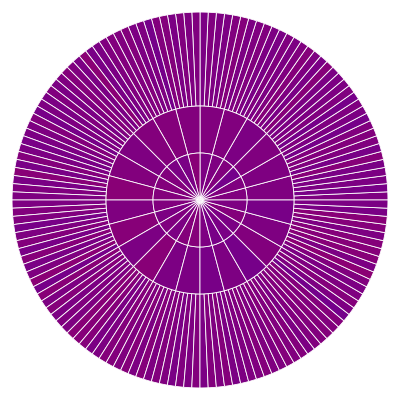

Plotting action 0...
(200, 200, 3)


/Users/jack.lingheng.meng/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:100: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


<IPython.core.display.Javascript object>


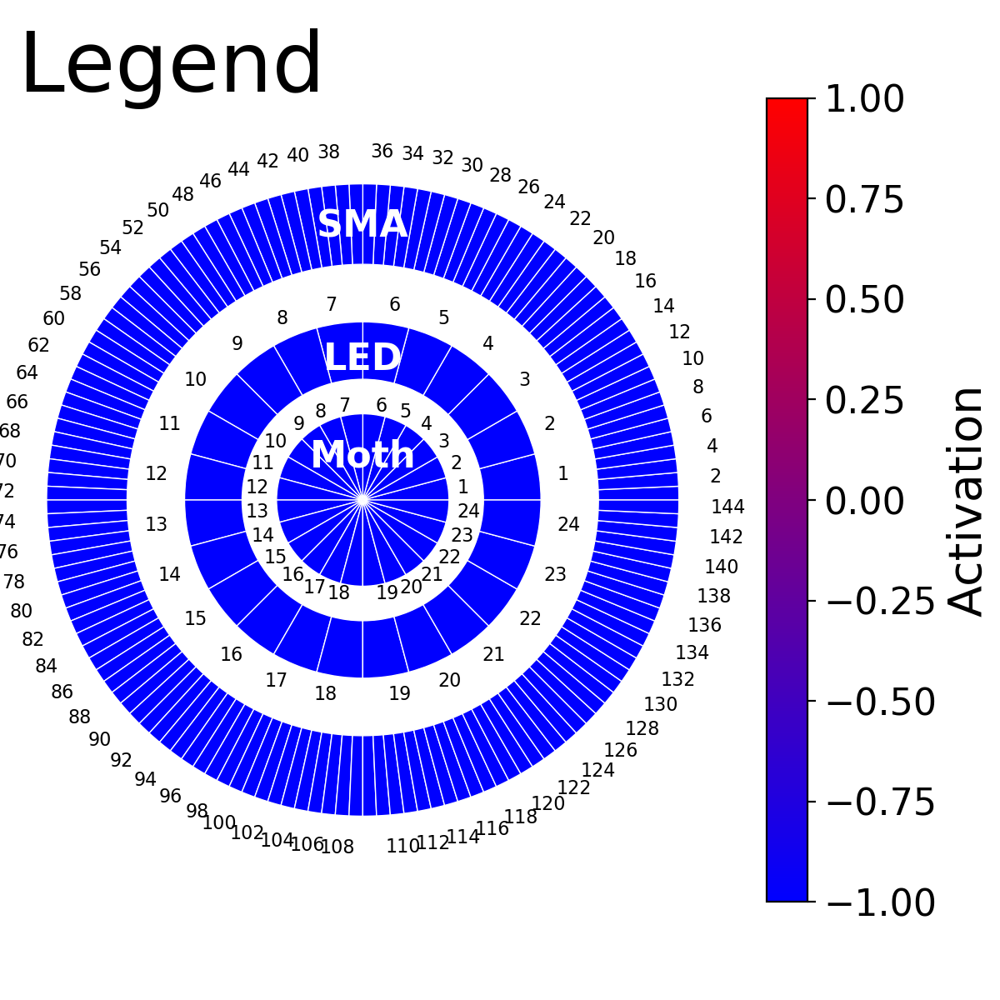

(600, 600, 3)


In [53]:
import matplotlib.colors as mcol
import matplotlib.cm as cm
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
from matplotlib import offsetbox
from sklearn import (manifold, datasets, decomposition, ensemble,
                     discriminant_analysis, random_projection)

def plot_action(X, index_sma, index_led, index_moth, fig, ax, canvas,add_label = False):
    """
       Plot action as pie chart. 
    """
    size = 0.2
    dim_SMA = 144
    dim_LED = 24
    dim_Moth = 24
    fan_SMA = np.ones(dim_SMA)
    fan_LED = np.ones(dim_LED)
    fan_Moth = np.ones(dim_Moth)
    
    #labels_SMA = np.arange(1,dim_SMA+1)
    labels_SMA = []
    for i in range(1, dim_SMA+1):
        if i % 2 ==0:
            labels_SMA.append(i)
        else:
            labels_SMA.append('')
    labels_LED = np.arange(1,dim_LED+1)
    labels_Moth = np.arange(1,dim_Moth+1)
    
    # Make a user-defined colormap.
    cm1 = mcol.LinearSegmentedColormap.from_list("MyCmapName",["b","r"])

    # Make a normalizer that will map the time values from
    # [start_time,end_time+1] -> [0,1].
    cnorm = mcol.Normalize(vmin=-1,vmax=1)

    # Turn these into an object that can be used to map time values to colors and
    # can be passed to plt.colorbar().
    cpick = cm.ScalarMappable(norm=cnorm,cmap=cm1)
    cpick.set_array([])
    
    for i in range(X.shape[0]):
        
        point = X[i,:]
        vals_SMA = point[index_sma]
        vals_LED = point[index_led]
        vals_Moth = point[index_moth]

        outer_colors = cpick.to_rgba(vals_SMA)
        middle_colors = cpick.to_rgba(vals_LED)
        inner_colors = cpick.to_rgba(vals_Moth)

        if add_label == True:
            
            ax.pie(fan_SMA, radius= size*5.5, colors=outer_colors, labels=labels_SMA,
                   wedgeprops=dict(width=0.28, edgecolor='w',linewidth=0.5),textprops={'fontsize': 8})

            ax.pie(fan_LED, radius= size*3.1, colors=middle_colors, labels=labels_LED,
                   wedgeprops=dict(width=size, edgecolor='w',linewidth=0.5), textprops={'fontsize': 8})

            ax.pie(fan_Moth, radius= 0.3, colors=inner_colors, labels=labels_Moth,
                   wedgeprops=dict(width=0.3, edgecolor='w',linewidth=0.5), textprops={'fontsize': 8})
            
            font_color = 'white'
            fontsize=16
            fontweight = 'bold'
            legend_label_loc = [[0,0.15],[0,0.49],[0,0.95]]
            legend_label = ['Moth', 'LED', 'SMA']
            for i in range(3):
                ax.text(legend_label_loc[i][0], legend_label_loc[i][1], legend_label[i], 
                        fontsize=fontsize,horizontalalignment='center', verticalalignment='center', 
                        color=font_color, fontweight=fontweight)
            
            cbar=plt.colorbar(cpick, shrink=0.8)
            cbar.set_label('Activation',size=20)
            cbar.ax.tick_params(labelsize=16) 
            plt.text(-1.2, 1.5, 'Legend', horizontalalignment='left', 
                     verticalalignment='center', fontsize=36)
        else:
            size = 0.3
            ax.pie(fan_SMA, radius= 1.2, colors=outer_colors, 
                   wedgeprops=dict(width=1.2-size*2, edgecolor='w',linewidth=0.3),textprops={'fontsize': 6})

            ax.pie(fan_LED, radius= size*2, colors=middle_colors, 
                   wedgeprops=dict(width=size, edgecolor='w',linewidth=0.3), textprops={'fontsize': 6})

            ax.pie(fan_Moth, radius= size*1, colors=inner_colors,
                   wedgeprops=dict(width=size, edgecolor='w',linewidth=0.3), textprops={'fontsize': 4})

        ax.set(aspect="equal")
        plt.tight_layout(pad=-0.1)
        if i % 200 == 0:
            print('Plotting action {}...'.format(i))
            plt.show()
        if add_label == True:
            plt.savefig('./figures/SARA_action_pie_plots/SARA_action_Legend.jpg'.format(i),dpi=300, bbox_inches='tight', pad_inches=0)
        else:
            plt.savefig('./figures/SARA_action_pie_plots/action_{}.jpg'.format(i),dpi=300, bbox_inches='tight', pad_inches=0)
        width, height = fig.get_size_inches() * fig.get_dpi()
        img = np.fromstring(canvas.tostring_rgb(), dtype='uint8').reshape(int(height), int(width), 3)
        return img
        
# get index of each type of actuators
index_sma = []
index_led = []
index_moth = []
for index, column_name in enumerate(list(action_df.columns)):
    if 'sma' in column_name:
        index_sma.append(index)
    elif 'light' in column_name:
        index_led.append(index)
    elif 'moth' in column_name:
        index_moth.append(index)
    else:
        print('not belong to sma, led and moth')

# used as embedding
action_fig, action_ax = plt.subplots(figsize=[2,2])
canvas = FigureCanvas(action_fig)
thumbnails = []
draw_thumbnails_index = [0]
for i in draw_thumbnails_index:
    image = plot_action(X[i:i+1,:], index_sma, index_led, index_moth, action_fig, action_ax, canvas)
    thumbnails.append(image)
print(image.shape)
# used as legend
action_fig, action_ax = plt.subplots(figsize=[6,6])
canvas = FigureCanvas(action_fig)
Legend_data = -np.ones([1,192])
image = plot_action(Legend_data, index_sma, index_led, index_moth, action_fig, action_ax, canvas,add_label = True)

print(image.shape)


In [76]:

#----------------------------------------------------------------------
# Scale and visualize the embedding vectors
def plot_embedding(X, X_original, file_name, color):
    x_min, x_max = np.min(X, 0), np.max(X, 0)
    X = (X - x_min) / (x_max - x_min)
    
    # figure used to plot embedding vectors
    embedding_fig, embedding_ax = plt.subplots(figsize=[60,60])
    embedding_ax.scatter(X[:, 0], X[:, 1], s=1000, c = color)
    
    # figure used to plot action pie chart
    action_fig, action_ax = plt.subplots(figsize=[2,2])
    canvas = FigureCanvas(action_fig)
    
    draw_thumbnails_index = []
    thumbnails_index = 0
    if hasattr(offsetbox, 'AnnotationBbox'):
        # only print thumbnails with matplotlib > 1.0
        shown_images = np.array([[1., 1.]])  # just something big
        for i in range(X.shape[0]):
            dist = np.sum((X[i] - shown_images) ** 2, 1)
            if np.min(dist) < 4e-3:
                # don't show points that are too close
                continue
            shown_images = np.r_[shown_images, [X[i]]]
            image = plot_action(X_original[i:i+1,:], index_sma, index_led, index_moth, action_fig, action_ax, canvas)
            imagebox = offsetbox.AnnotationBbox(offsetbox.OffsetImage(image), X[i], pad=0)
            thumbnails_index += 1
            embedding_ax.add_artist(imagebox)
            print(i)
            draw_thumbnails_index.append(i)
    
    embedding_ax.set_xticks([])
    embedding_ax.set_yticks([])
    
    embedding_fig.show()
    embedding_fig.savefig('./figures/SARA_action_pie_plots/{}.jpg'.format(file_name),dpi=200, bbox_inches='tight', pad_inches=0)
    
    return draw_thumbnails_index



In [77]:
# draw_thumbnails_index = plot_embedding(X_2d[:,:], X[:,:], 
#                                        't_SNE_all')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


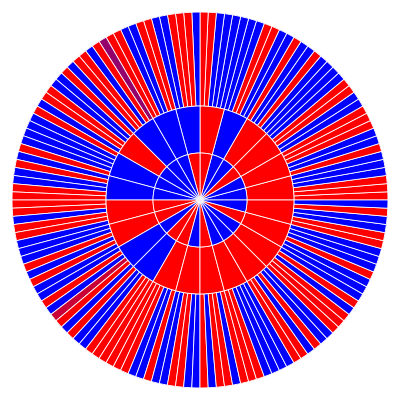

Plotting action 0...
0


/Users/jack.lingheng.meng/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:100: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead


Plotting action 0...
52
Plotting action 0...
71
Plotting action 0...
114
Plotting action 0...
157
Plotting action 0...
257
Plotting action 0...
292
Plotting action 0...
339
Plotting action 0...
425
Plotting action 0...
506
Plotting action 0...
521
Plotting action 0...
591
Plotting action 0...
686
Plotting action 0...
688
Plotting action 0...
772
Plotting action 0...
851
Plotting action 0...
948
Plotting action 0...
1014
Plotting action 0...
1101
Plotting action 0...
1114
Plotting action 0...
1181
Plotting action 0...
1266
Plotting action 0...
1347
Plotting action 0...
1423
Plotting action 0...
1501
Plotting action 0...
1550
Plotting action 0...
1583
Plotting action 0...
1659
Plotting action 0...
1666
Plotting action 0...
1704
Plotting action 0...
1744
Plotting action 0...
1816
Plotting action 0...
1845
Plotting action 0...
1899
Plotting action 0...
2055
Plotting action 0...
2112
Plotting action 0...
2202
Plotting action 0...
2279
Plotting action 0...
2352
Plotting action 0...
2367
Plot

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


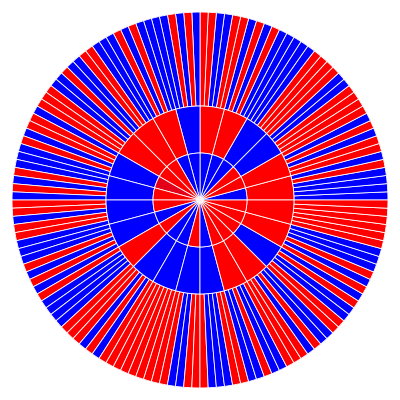

Plotting action 0...
0
Plotting action 0...
1
Plotting action 0...
17
Plotting action 0...
25
Plotting action 0...
48
Plotting action 0...
74
Plotting action 0...
143
Plotting action 0...
230
Plotting action 0...
309
Plotting action 0...
382
Plotting action 0...
427
Plotting action 0...
461
Plotting action 0...
537
Plotting action 0...
619
Plotting action 0...
625
Plotting action 0...
716
Plotting action 0...
784
Plotting action 0...
801
Plotting action 0...
864
Plotting action 0...
948
Plotting action 0...
967
Plotting action 0...
969
Plotting action 0...
1015
Plotting action 0...
1047
Plotting action 0...
1096
Plotting action 0...
1103
Plotting action 0...
1194
Plotting action 0...
1270
Plotting action 0...
1324
Plotting action 0...
1359
Plotting action 0...
1445
Plotting action 0...
1506
Plotting action 0...
1590
Plotting action 0...
1637
Plotting action 0...
1704
Plotting action 0...
1762
Plotting action 0...
1834
Plotting action 0...
1842
Plotting action 0...
1917
Plotting action 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


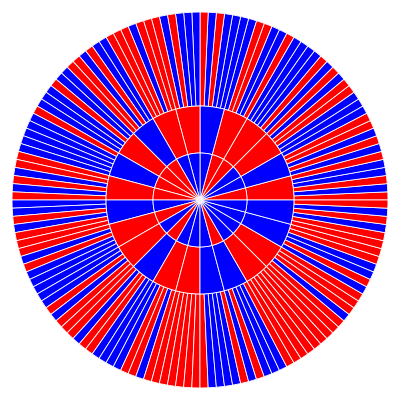

Plotting action 0...
0
Plotting action 0...
1
Plotting action 0...
8
Plotting action 0...
10
Plotting action 0...
19
Plotting action 0...
48
Plotting action 0...
69
Plotting action 0...
91
Plotting action 0...
118
Plotting action 0...
215
Plotting action 0...
323
Plotting action 0...
368
Plotting action 0...
433
Plotting action 0...
465
Plotting action 0...
514
Plotting action 0...
562
Plotting action 0...
640
Plotting action 0...
721
Plotting action 0...
817
Plotting action 0...
886
Plotting action 0...
900
Plotting action 0...
901
Plotting action 0...
945
Plotting action 0...
982
Plotting action 0...
983
Plotting action 0...
986
Plotting action 0...
1063
Plotting action 0...
1075
Plotting action 0...
1169
Plotting action 0...
1246
Plotting action 0...
1326
Plotting action 0...
1349
Plotting action 0...
1396
Plotting action 0...
1404
Plotting action 0...
1458
Plotting action 0...
1474
Plotting action 0...
1553
Plotting action 0...
1631
Plotting action 0...
1708
Plotting action 0...
17

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


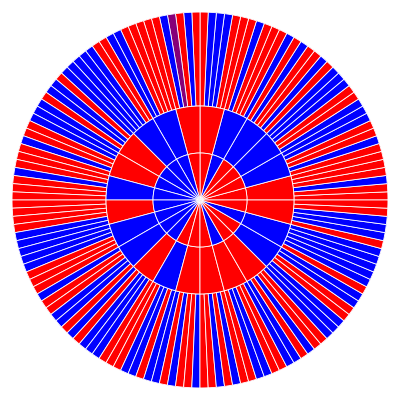

Plotting action 0...
0
Plotting action 0...
1
Plotting action 0...
5
Plotting action 0...
10
Plotting action 0...
24
Plotting action 0...
68
Plotting action 0...
89
Plotting action 0...
118
Plotting action 0...
185
Plotting action 0...
199
Plotting action 0...
283
Plotting action 0...
348
Plotting action 0...
369
Plotting action 0...
380
Plotting action 0...
432
Plotting action 0...
454
Plotting action 0...
477
Plotting action 0...
566
Plotting action 0...
655
Plotting action 0...
752
Plotting action 0...
848
Plotting action 0...
916
Plotting action 0...
983
Plotting action 0...
1017
Plotting action 0...
1085
Plotting action 0...
1106
Plotting action 0...
1305
Plotting action 0...
1334
Plotting action 0...
1356
Plotting action 0...
1465
Plotting action 0...
1491
Plotting action 0...
1591
Plotting action 0...
1654
Plotting action 0...
1717
Plotting action 0...
1766
Plotting action 0...
1870
Plotting action 0...
1933
Plotting action 0...
2000
Plotting action 0...
2060
Plotting action 0..

[0,
 1,
 5,
 10,
 24,
 68,
 89,
 118,
 185,
 199,
 283,
 348,
 369,
 380,
 432,
 454,
 477,
 566,
 655,
 752,
 848,
 916,
 983,
 1017,
 1085,
 1106,
 1305,
 1334,
 1356,
 1465,
 1491,
 1591,
 1654,
 1717,
 1766,
 1870,
 1933,
 2000,
 2060,
 2133,
 2162,
 2310,
 2326,
 2384,
 2455,
 2543,
 2611,
 2685,
 2775,
 2833,
 2857,
 2888,
 2970,
 2992,
 3075]

In [78]:
plot_embedding(X_2d[:day_1,:], X[:day_1,:], 
               't_SNE_SARA_day1', 'blue')

plot_embedding(X_2d[day_1:day_1+day_2,:], X[day_1:day_1+day_2,:], 
               't_SNE_SARA_day2', 'orange')

plot_embedding(X_2d[day_1+day_2:day_1+day_2+day_3,:], X[day_1+day_2:day_1+day_2+day_3,:], 
               't_SNE_SARA_day3', 'green')

plot_embedding(X_2d[day_1+day_2+day_3:,:], X[day_1+day_2+day_3:,:], 
               't_SNE_SARA_day4','red')


<IPython.core.display.Javascript object>


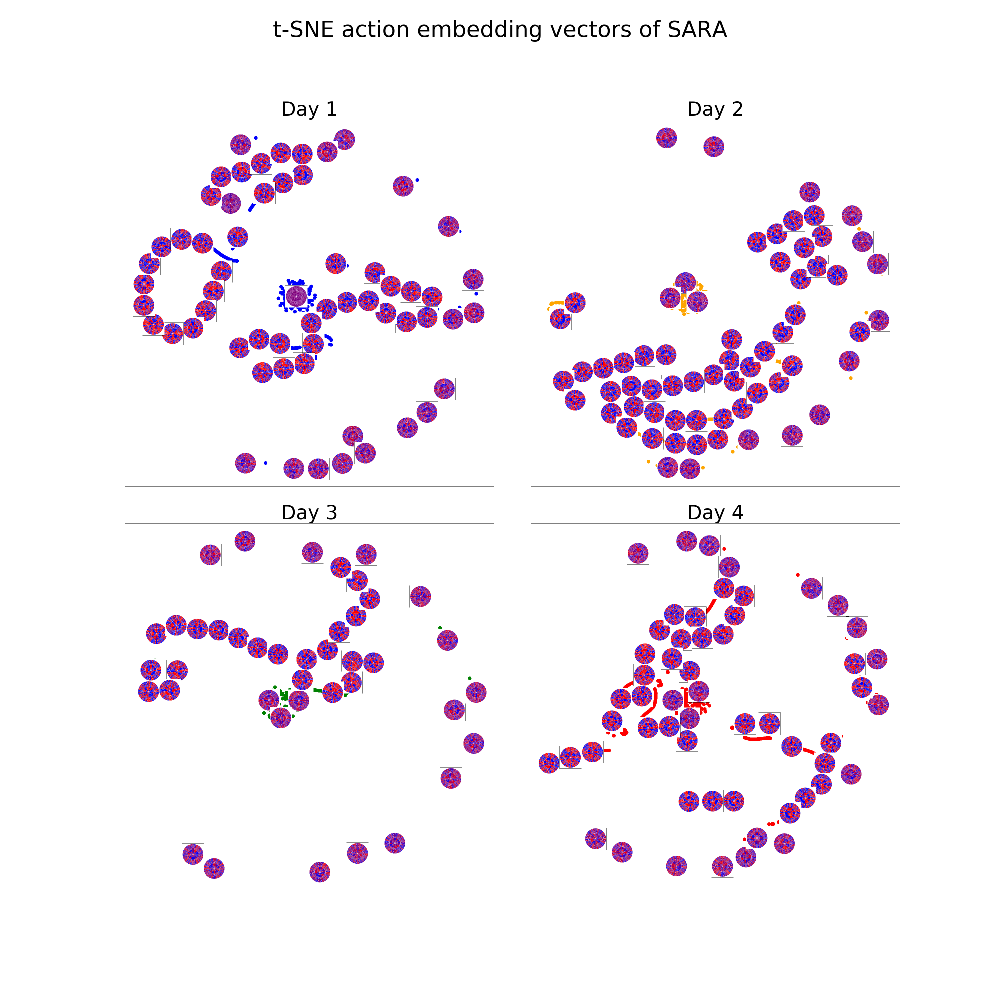

In [79]:

fig = plt.figure(figsize=[20,20])
fig.suptitle('t-SNE action embedding vectors of SARA',fontsize=32) 

colors = ['blue', 'orange', 'green', 'red']
for i in range(4):
    plt.subplot(2,2,i+1)
    img = plt.imread('./figures/SARA_action_pie_plots/t_SNE_SARA_day{}.jpg'.format(i+1))
    plt.imshow(img)
    plt.axis('off')
    plt.title('Day {}'.format(i+1),fontsize=28)
# # add Legend
# plt.subplot(4,4,4*4)
# img = plt.imread('./figures/SARA_action_pie_plots/SARA_action_Legend.jpg')
# plt.imshow(img)
# plt.axis('off')
# #plt.title('Legend',fontsize=28)

plt.subplots_adjust(wspace = 0.1, hspace = 0.1)

#plt.tight_layout()
plt.savefig('./figures/SARA_action_pie_plots/t_SNE_action_embedding_vectors_of_SARA_On_Each_Day_with_data_point.jpg',
         dpi=300, bbox_inches='tight', pad_inches=0)

# Examine Dispersion on each day

In [19]:
print(np.std(X_2d[:day_1,:], 0))

print(np.std(X_2d[day_1:day_1+day_2,:], 0))

print(np.std(X_2d[day_1+day_2:day_1+day_2+day_3,:], 0))

print(np.std(X_2d[day_1+day_2+day_3:,:], 0))



[50.85772  43.405384]
[49.591656 44.65583 ]
[46.79367  25.003567]
[43.216614 45.06836 ]
